In [1]:
%load_ext autoreload
%autoreload 2

%config InlineBackend.figure_format = 'retina'

In [2]:
import scanpy as sc 
import sys 
sys.path.append('../../src')

from spaceoracle.prophets import Prophet

2025-01-15 18:21:41.841213: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [3]:
adata_train = sc.read_h5ad(
    '/ix/djishnu/shared/djishnu_kor11/training_data/day3_lymph_rep_1.h5ad')

pythia = Prophet(
    adata=adata_train,
    models_dir='/ix/djishnu/shared/djishnu_kor11/models_v2',
    annot='rctd_cluster',
    annot_labels='rctd_celltypes'
)

In [4]:
# import pandas as pd 

# tfh_genes = pd.read_csv('/ix/djishnu/Alisa/Tfh/croty_list.csv', index_col=0)
# candidates = tfh_genes['Genes']

In [5]:
pythia.compute_betas()
pythia.beta_dict.ligands_set # These are the only active ligands 

100%|██████████| 2000/2000 [02:10<00:00, 15.35it/s]


{'Angpt2',
 'Angptl4',
 'C3',
 'C4b',
 'Ccl11',
 'Ccl2',
 'Ccl20',
 'Ccl4',
 'Ccl5',
 'Ccl6',
 'Ccl7',
 'Ccl8',
 'Csf1',
 'Cxcl1',
 'Cxcl13',
 'Cxcl9',
 'Ebi3',
 'Gdf10',
 'Gzma',
 'Il12b',
 'Il15',
 'Il2',
 'Il21',
 'Il24',
 'Il4',
 'Il7',
 'Lif',
 'Lta',
 'Osm',
 'Sema3a',
 'Sema3d',
 'Tnfsf13b',
 'Tnfsf14'}

In [12]:
import commot as ct 
df_ligrec = ct.pp.ligand_receptor_database(
                database='CellChat', 
                species='mouse', 
                signaling_type="Secreted Signaling"
            )

In [22]:
ligrecs = set([x for sublist in df_ligrec['1'].str.split('_') for x in sublist])
print(len(ligrecs))

import numpy as np 
np.savetxt('../../data/slideseq/ligrecs.txt', sorted(ligrecs), fmt='%s')

327


In [5]:
goi = 'Il2'
goi in pythia.adata.var_names

True

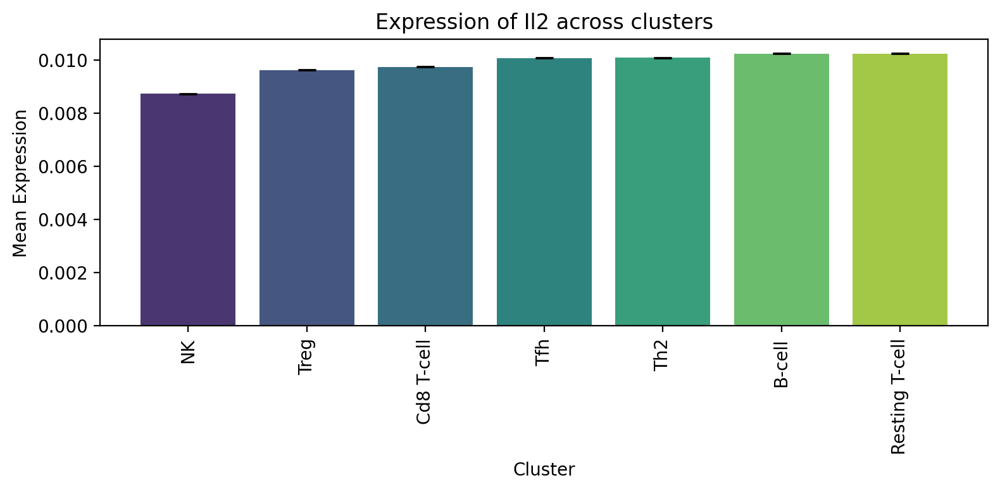

In [6]:
df = pythia.show_ct_gex(goi)

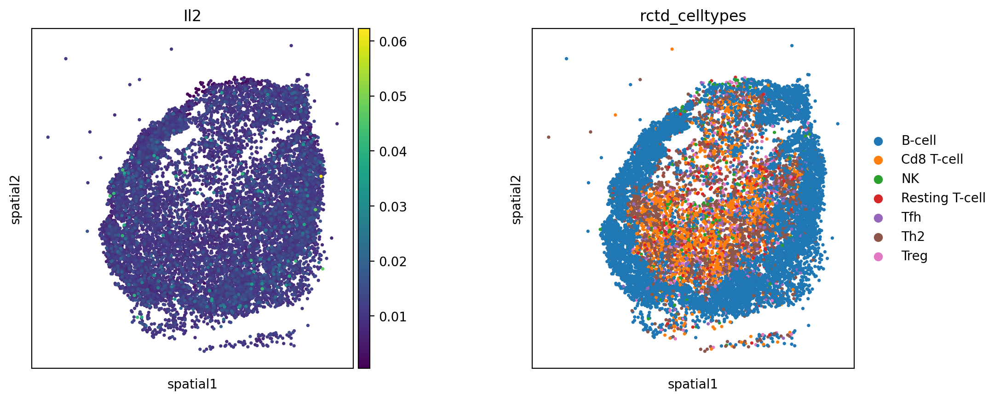

In [9]:
# pythia.show_cluster_gex(goi=goi, embedding='spatial')
pythia.show_cluster_gex(goi=goi, embedding='spatial', include_ct=[], show_locs=True)

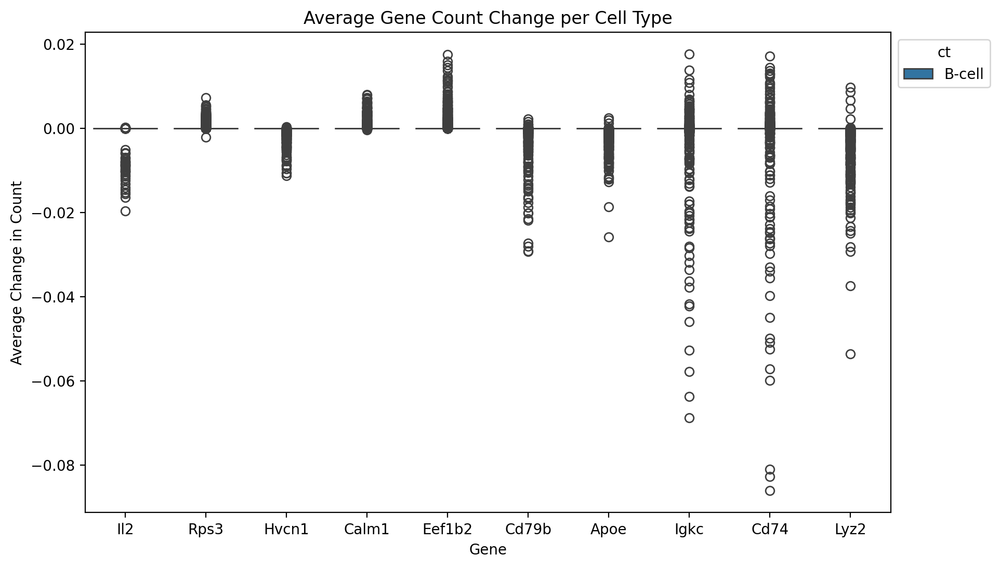

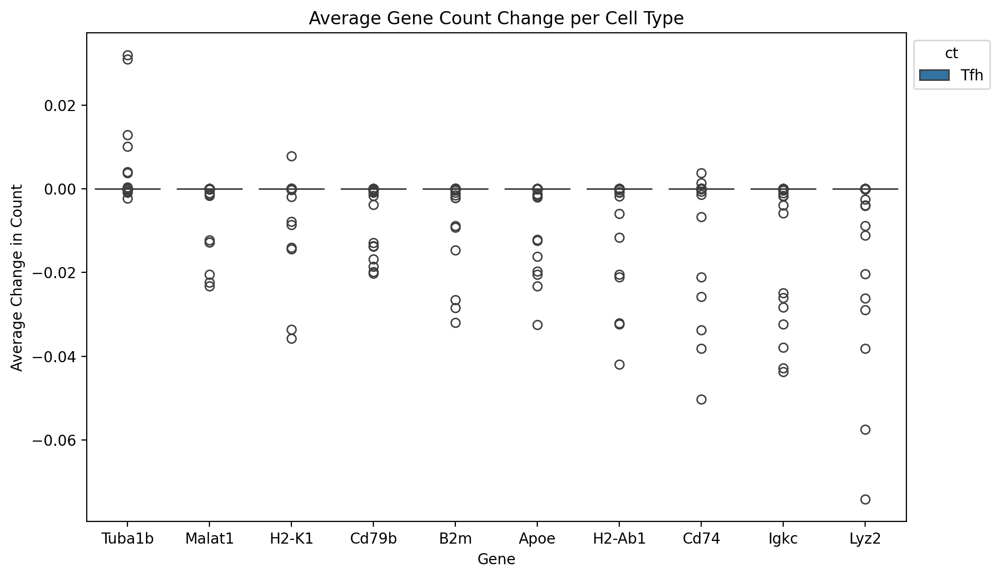

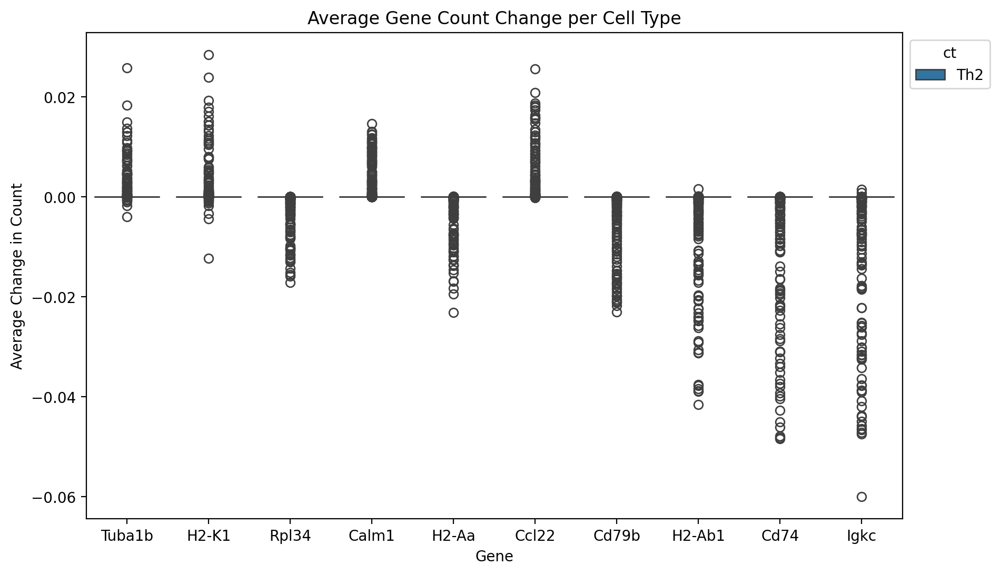

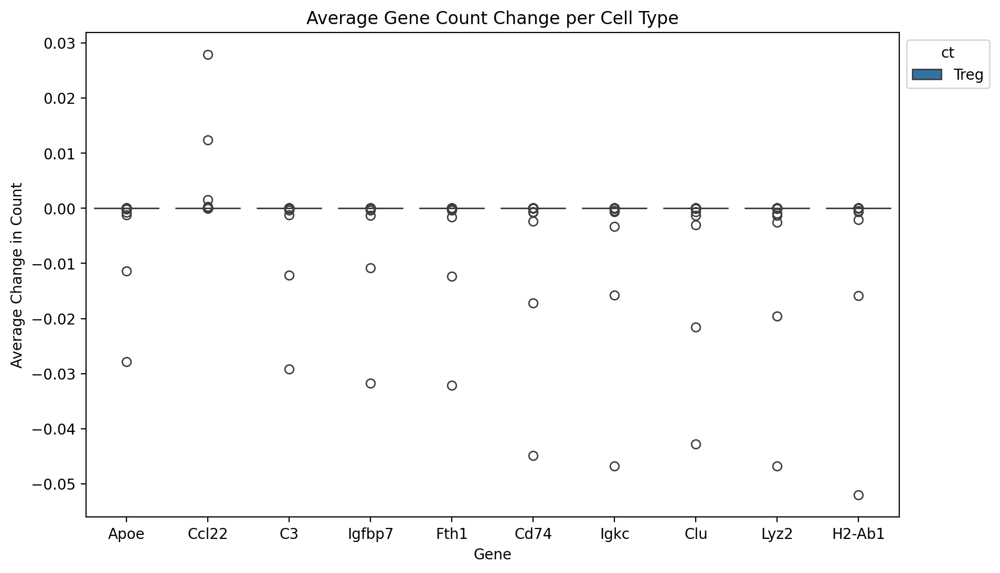

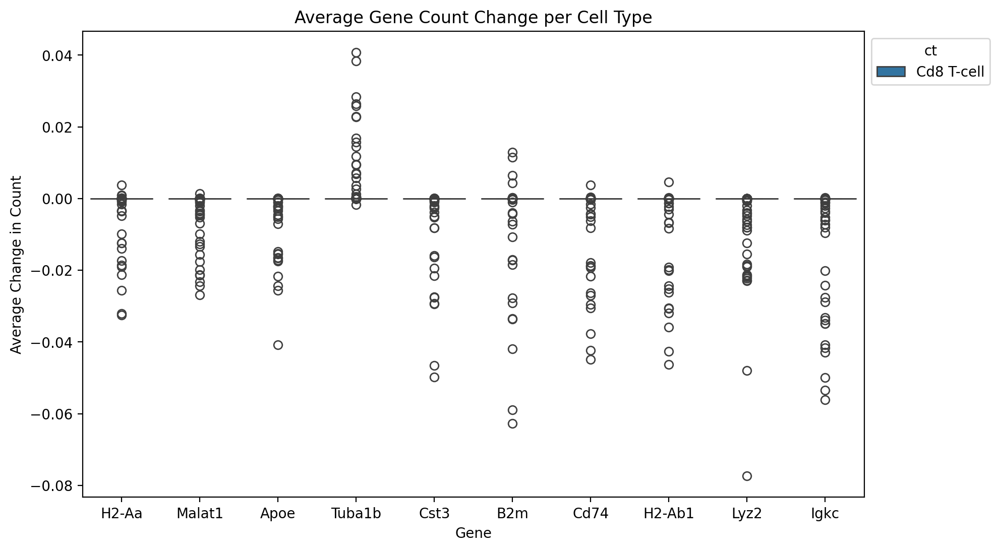

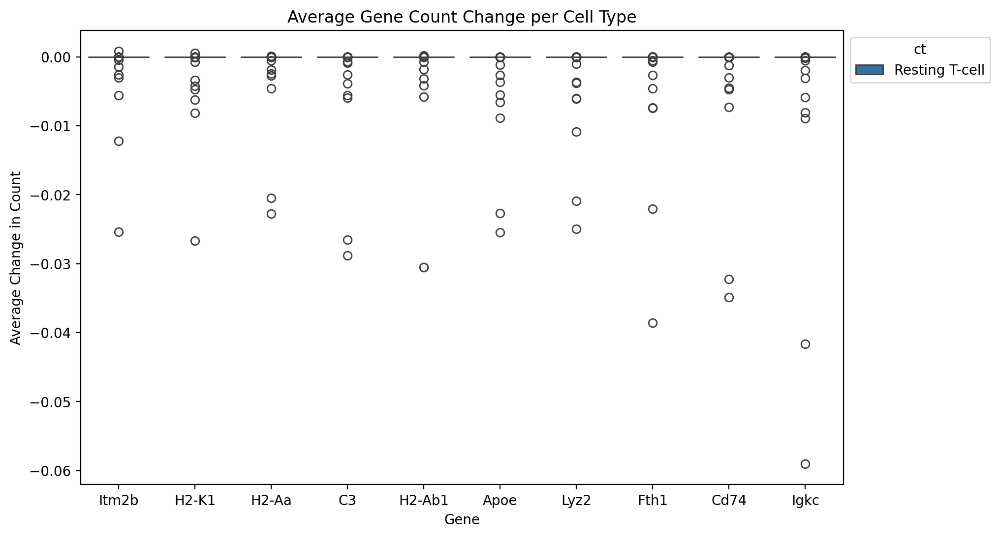

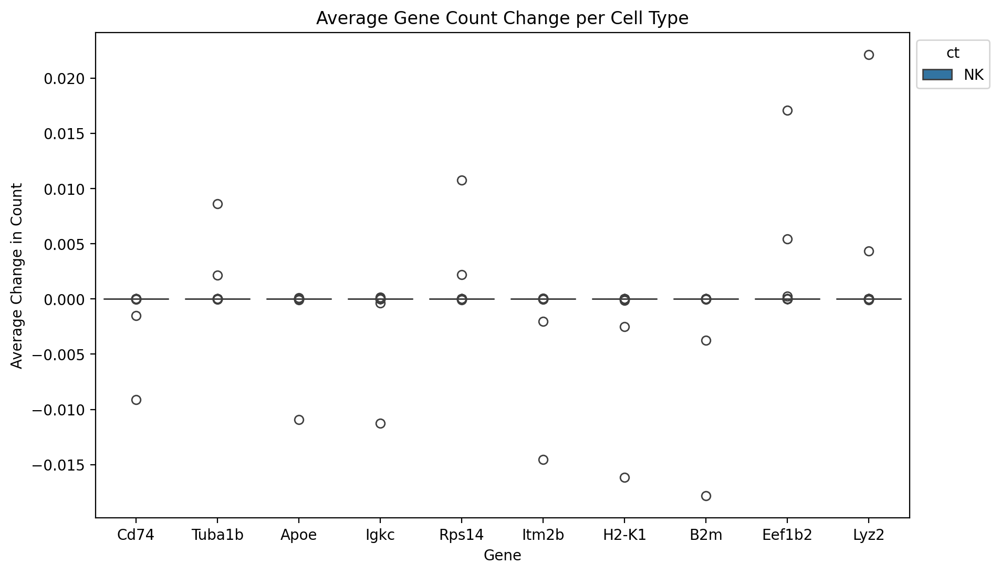

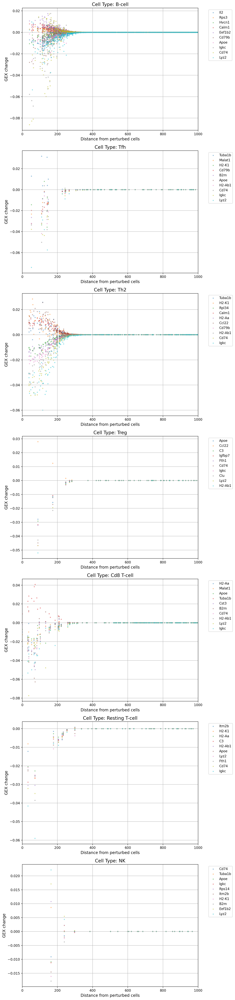

In [18]:
chosen_cell = [-1525.6, 3173.9]
save_dir = f'/ix/djishnu/shared/djishnu_kor11/results/lymph/locations/{goi}/{chosen_cell[0]}_{chosen_cell[1]}/'
pythia.perturb_location(
    chosen_cell, goi=goi, 
    cell_type=[], 
    n_propagation=3, 
    radius_ko=150, 
    save_dir=save_dir
)

In [ ]:
save_dir = '/ix/djishnu/shared/djishnu_kor11/results/lymph'
pythia.plot_contour_shift(savepath=f'{save_dir}/contours/{goi}.png')

In [ ]:
pythia.show_cluster_gex(embedding='UMAP')

In [ ]:
pythia.show_transitions(
    vector_scale=1, 
    layout_embedding=pythia.adata.obsm['spatial'],
    nn_embedding=pythia.adata.obsm['spatial'],
    grid_scale=3,
    savepath=f'{save_dir}/transitions_{goi}.png'
)
pythia.show_transitions(
    vector_scale=1, 
    layout_embedding=pythia.adata.obsm['X_umap'],
    nn_embedding=pythia.adata.obsm['spatial'],
    grid_scale=3,
    savepath=f'{save_dir}/transitions_{goi}.png'
)

In [ ]:
pythia.plot_delta_scores(n_show=5, compare_ct=False)
pythia.plot_delta_scores(n_show=5, compare_ct=True)


In [ ]:
adata = pythia.adata.copy()
hvar_genes = {}

for ct in adata.obs['rctd_celltypes'].unique():
    adata_ct = adata[adata.obs['rctd_celltypes'] == ct]
    n_top_genes = adata_ct.shape[1] // 10               # get top 10%
    sc.pp.highly_variable_genes(adata_ct, n_top_genes=n_top_genes)
    hvar_genes[ct] = adata_ct.var_names[adata_ct.var['highly_variable']]

hvar_genes

In [ ]:
goi = 'Il2'
goi in pythia.adata.var_names

True

Ligand interactions: 100%|██████████| 2000/2000 [05:03<00:00,  6.60it/s]


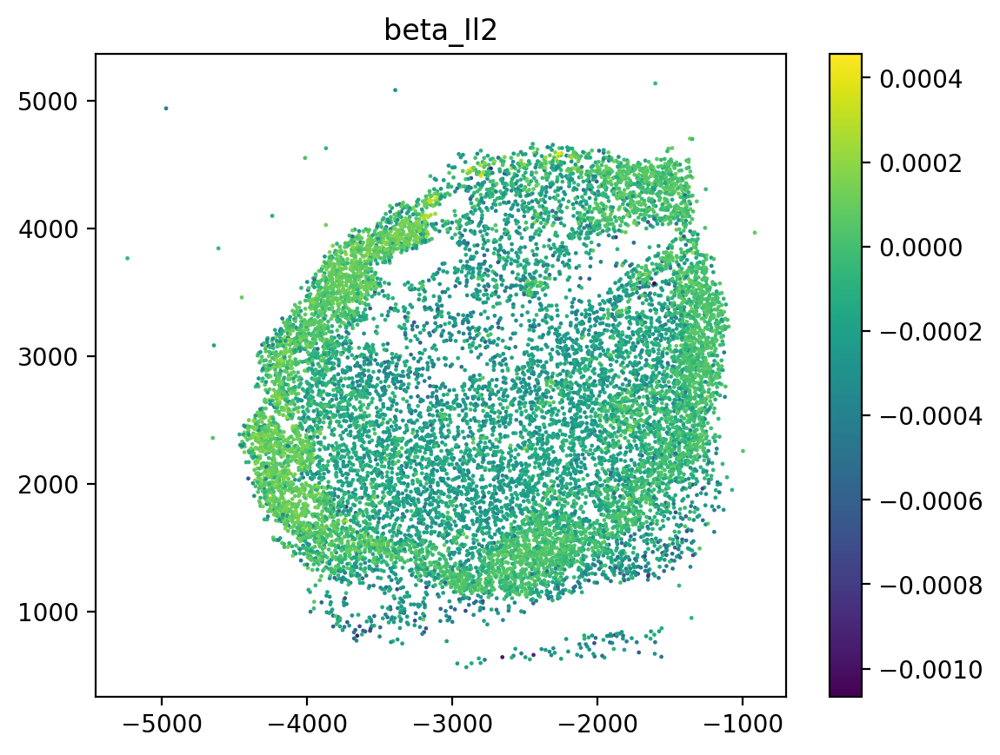

In [40]:
pythia.plot_betas_goi(goi)

In [41]:
pythia.perturb(target=goi, n_propagation=1, gene_expr=0)

Running simulation 1/1: 100%|██████████| 11567/11567 [12:19<00:00, 15.64it/s] 


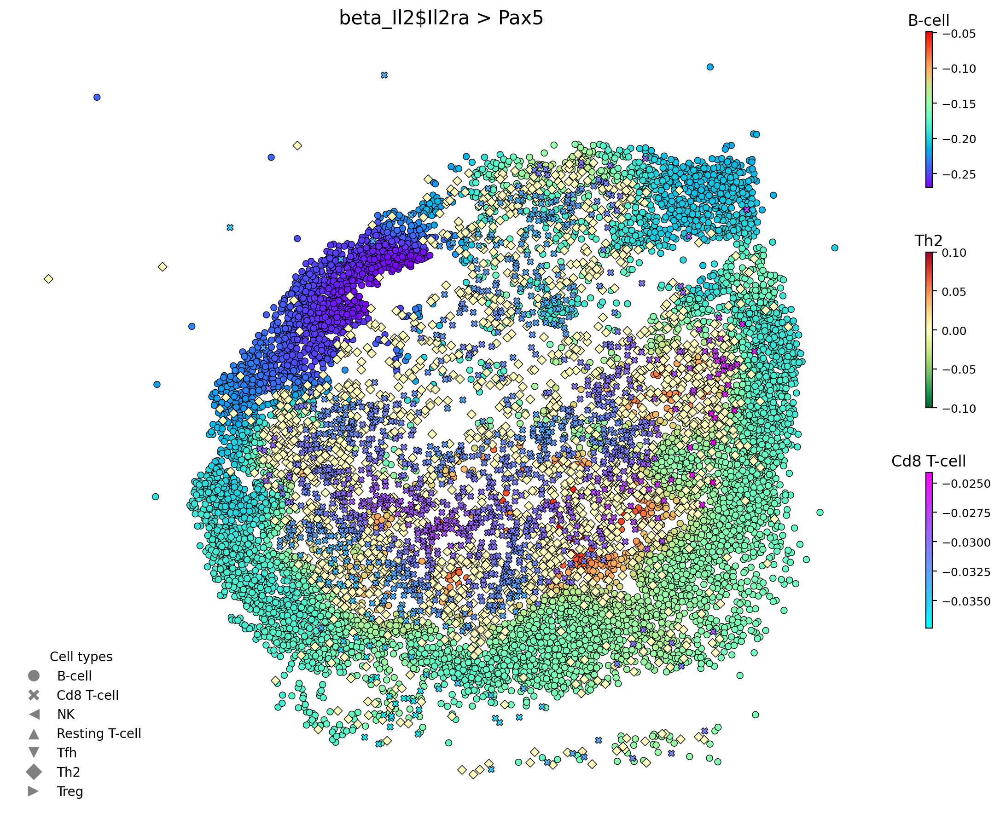

In [7]:
pythia.plot_beta_map(
    regulator='Il2$Il2ra', 
    target_gene='Pax5'
)

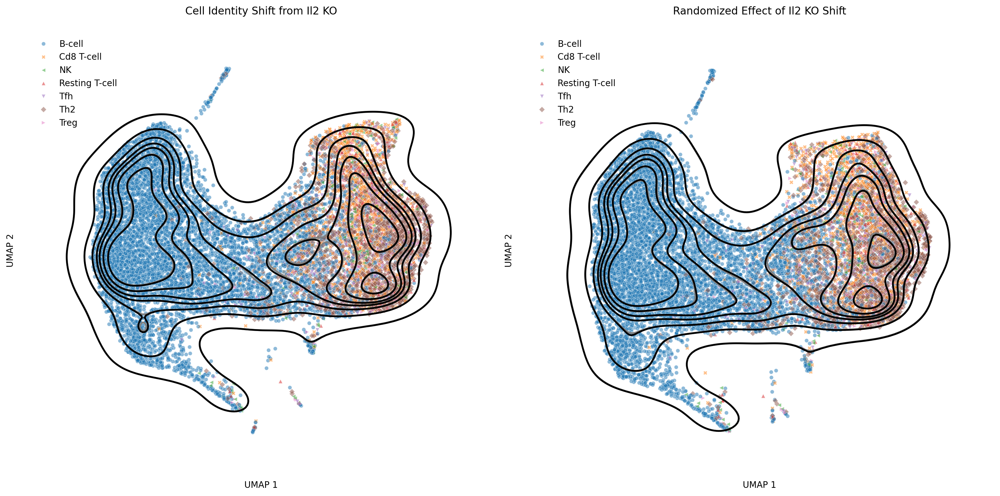

In [13]:
save_dir = '/ix/djishnu/shared/djishnu_kor11/results/lymph'
pythia.plot_contour_shift(savepath=f'{save_dir}/transitions/contours/{goi}.png')

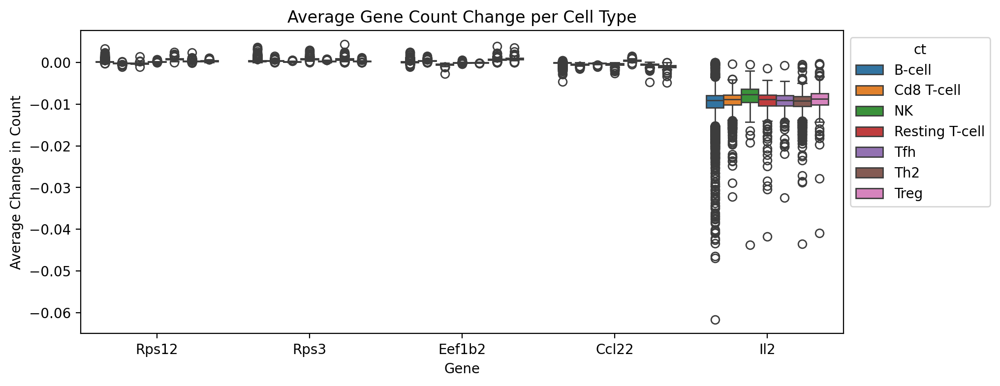

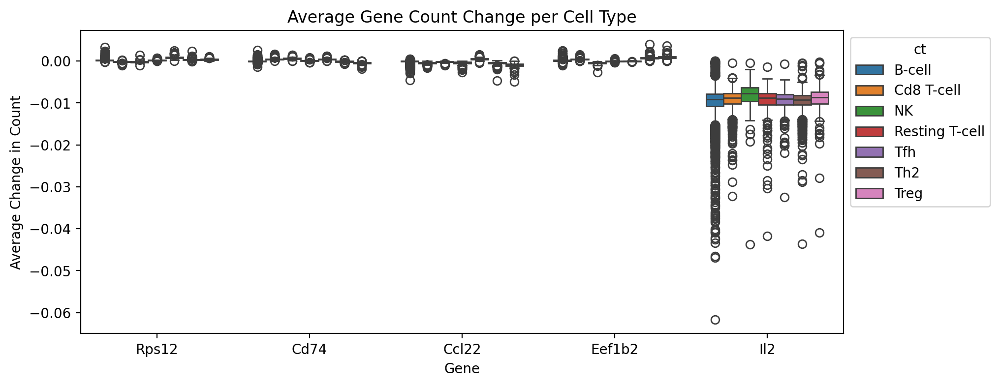

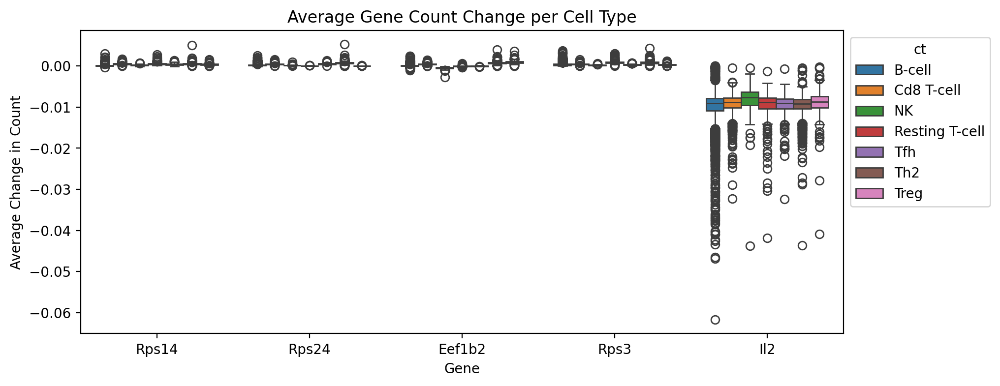

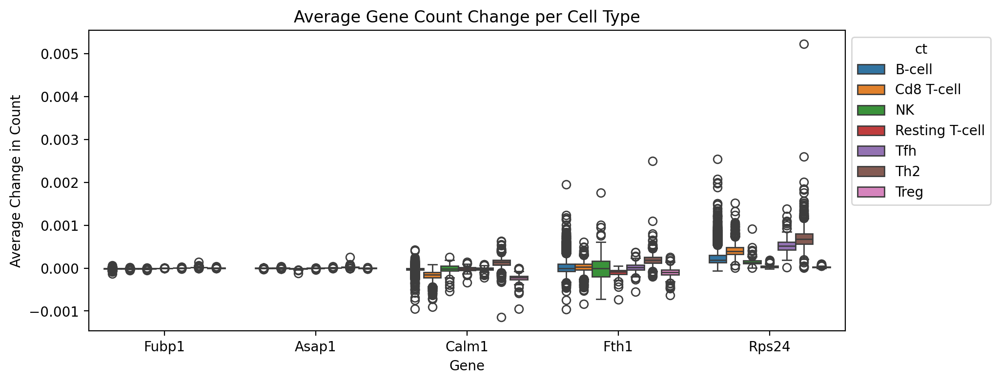

In [18]:
pythia.plot_delta_scores(n_show=5, compare_ct=False)
pythia.plot_delta_scores(n_show=5, compare_ct=True)

pythia.plot_delta_scores(n_show=5, compare_ct=False, ct_interest='Th2')
pythia.plot_delta_scores(n_show=5, compare_ct=True, ct_interest='Th2')

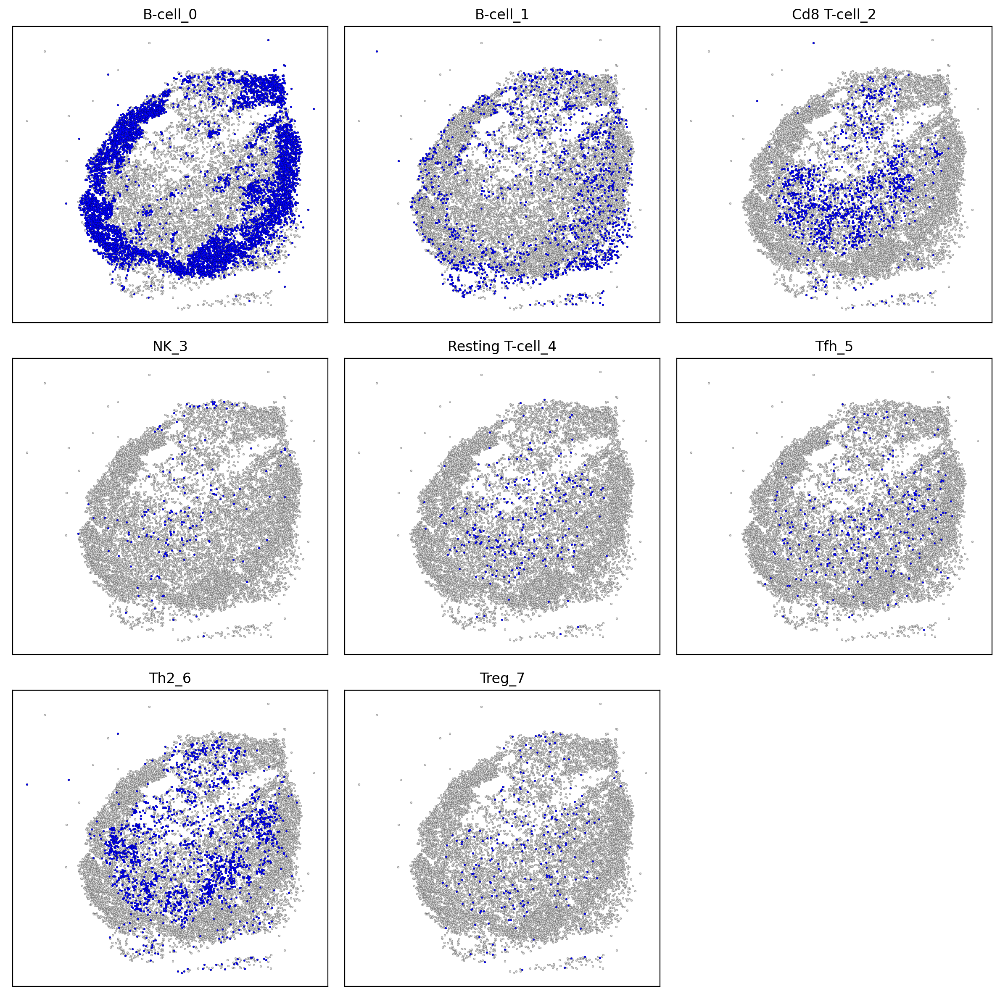

In [30]:
# Running plot_beta_neighborhoods will add a new 'beta_neighborhood' key to the adata.obs

# pythia.plot_beta_neighborhoods(
#     use_modulators=True,
#     savepath=f'{save_dir}/neighborhoods/{goi}_betas.png'
# )

pythia.plot_beta_neighborhoods(
    use_modulators=False,
    savepath=f'{save_dir}/neighborhoods/beta_{goi}.png'
)

In [31]:
pythia.adata.obs['beta_neighborhood'].value_counts()

B-cell_0            6049
Th2_6               1785
B-cell_1            1482
Cd8 T-cell_2        1246
Tfh_5                323
Resting T-cell_4     274
Treg_7               241
NK_3                 167
Name: beta_neighborhood, dtype: int64

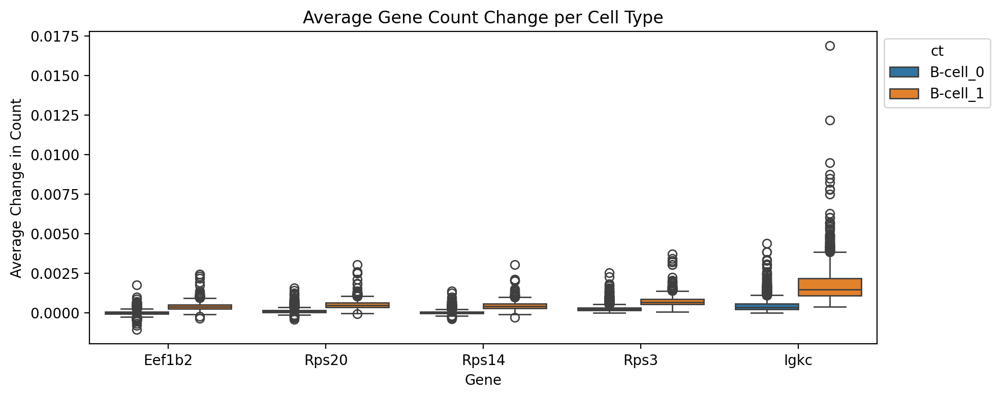

In [37]:
pythia.plot_delta_scores(n_show=5, compare_ct=True, ct_interest='B-cell_0',
                         alt_annot='beta_neighborhood', include=['B-cell_0', 'B-cell_1'])

In [44]:
pythia.adata.obs['grid_labels'].value_counts()

18_B-cell    519
21_B-cell    516
30_B-cell    515
38_B-cell    445
42_B-cell    394
            ... 
6_Tfh          1
58_Th2         1
49_Th2         1
22_Treg        1
70_B-cell      1
Name: grid_labels, Length: 246, dtype: int64

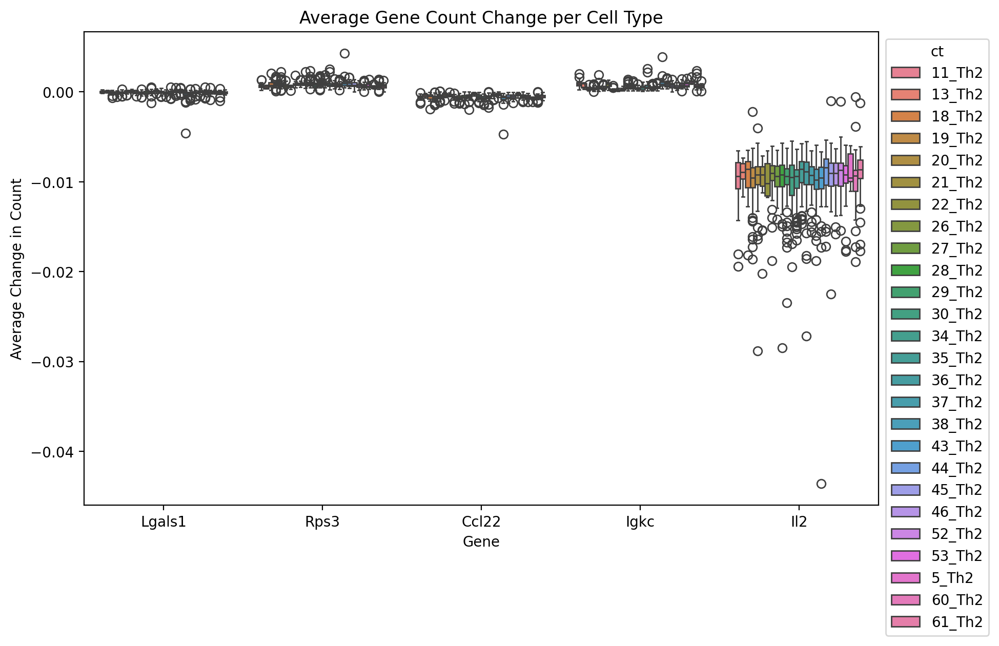

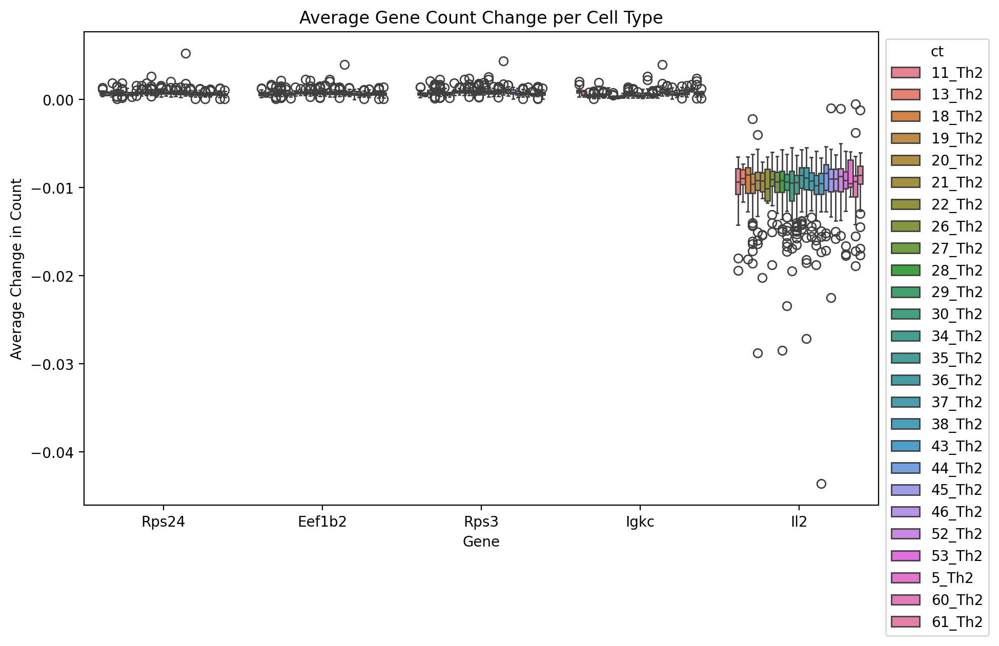

In [50]:
pythia.plot_delta_scores(n_show=5, compare_ct=True, alt_annot='grid_labels', 
                         include=[x for x in pythia.adata.obs['grid_labels'].unique() if 'Th2' in x])
pythia.plot_delta_scores(n_show=5, compare_ct=False, alt_annot='grid_labels',
                         include=[x for x in pythia.adata.obs['grid_labels'].unique() if 'Th2' in x])

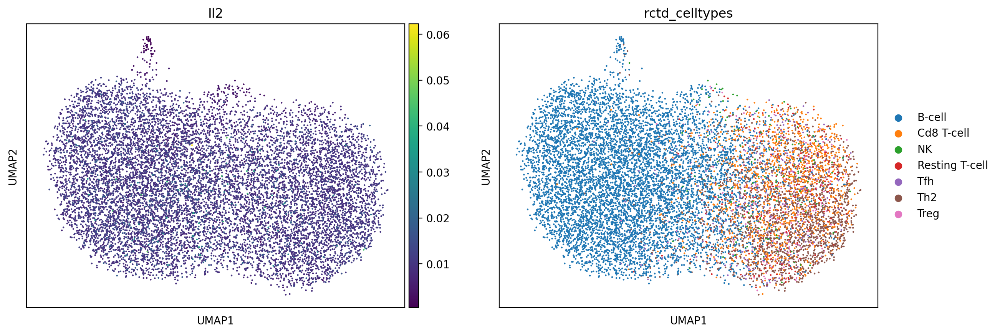

In [42]:
pythia.show_cluster_gex(embedding='UMAP')

Computing vectors: 100%|██████████| 2268/2268 [00:00<00:00, 34572.21it/s]


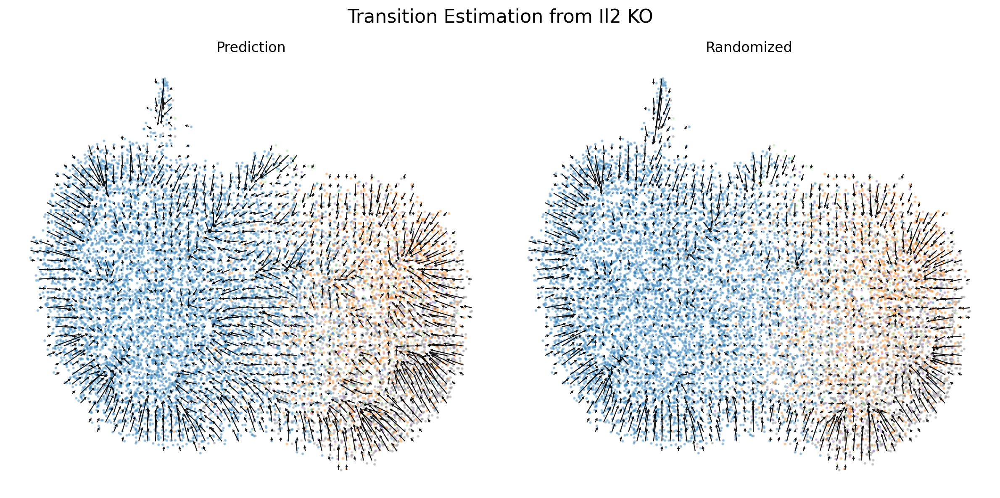

Computing vectors: 100%|██████████| 2268/2268 [00:00<00:00, 37317.37it/s]


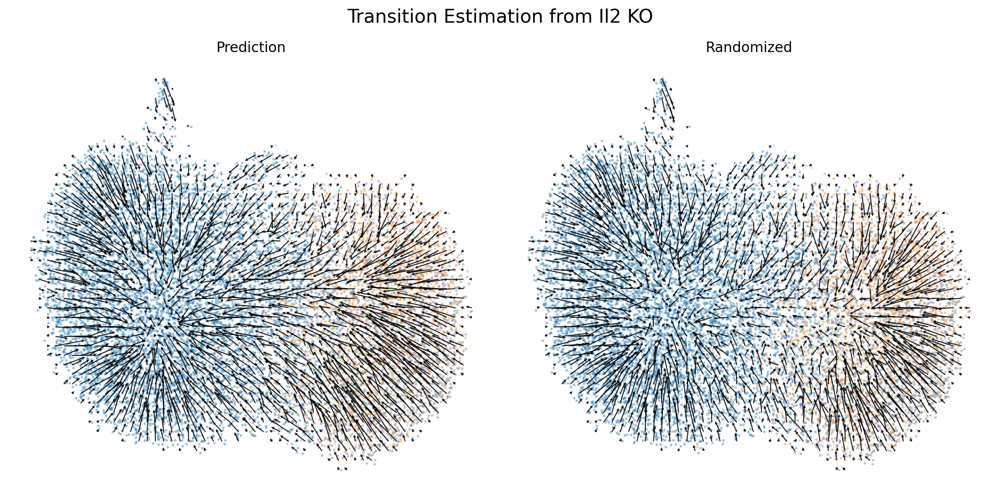

Computing vectors: 100%|██████████| 600/600 [00:00<00:00, 32775.68it/s]


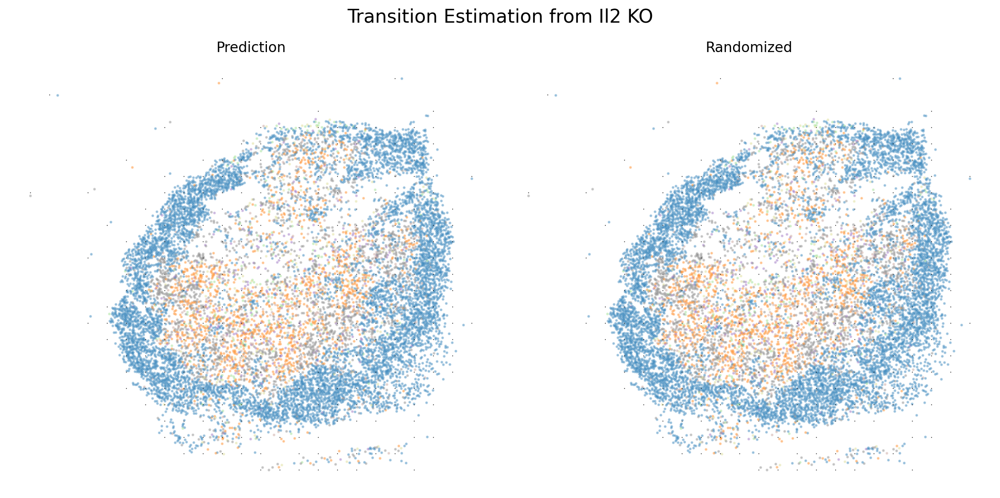

In [43]:
pythia.show_transitions(
    vector_scale=1, 
    layout_embedding=pythia.adata.obsm['X_umap'],
    nn_embedding=pythia.adata.obsm['X_umap'],
    grid_scale=3,
    savepath=f'{save_dir}/transitions_{goi}.png'
)
pythia.show_transitions(
    vector_scale=1, 
    layout_embedding=pythia.adata.obsm['X_umap'],
    nn_embedding=pythia.adata.obsm['spatial'],
    grid_scale=3,
    savepath=f'{save_dir}/transitions_{goi}.png'
)
pythia.show_transitions(
    vector_scale=1, 
    layout_embedding=pythia.adata.obsm['spatial'],
    nn_embedding=pythia.adata.obsm['spatial'],
    grid_scale=3,
    savepath=f'{save_dir}/transitions_{goi}.png'
)

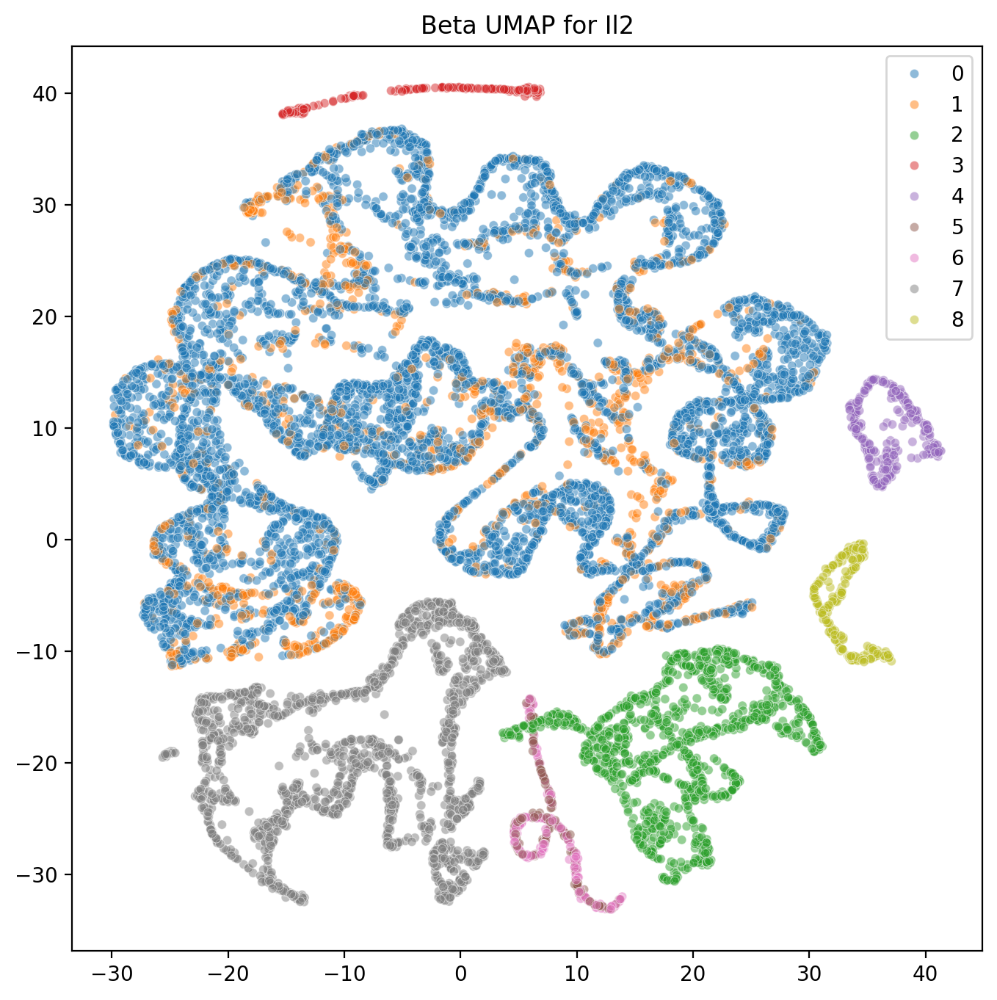

In [15]:
# Use clusters from betas

# pythia.show_cluster_gex(annot='beta_neighborhood', embedding='FR')
pythia.plot_beta_umap(use_modulators=True)

0.9432478513768622


Computing vectors: 100%|██████████| 4760/4760 [00:00<00:00, 39516.43it/s]


0.9432478513768622


Computing vectors: 100%|██████████| 4760/4760 [00:00<00:00, 39073.06it/s]


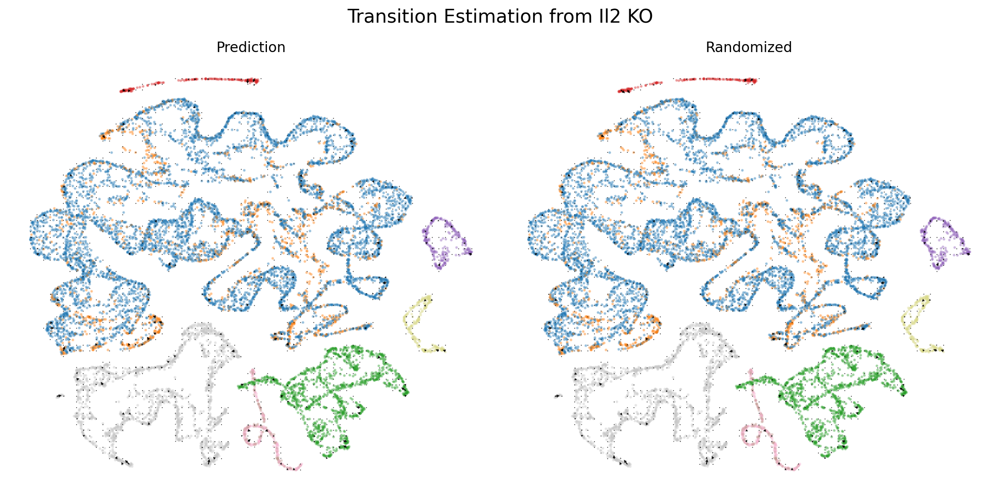

In [16]:
pythia.show_transitions(
    layout_embedding=pythia.adata.obsm['beta_umap'],
    nn_embedding=pythia.adata.obsm['beta_umap'],
    grid_scale=2,
    vector_scale=1, 
    annot='beta_neighborhood',
    savepath=f'{save_dir}/transitions/beta/{goi}_neighborhoods.png')